Added grain at (12, 32). Avalanche size (waves): 0


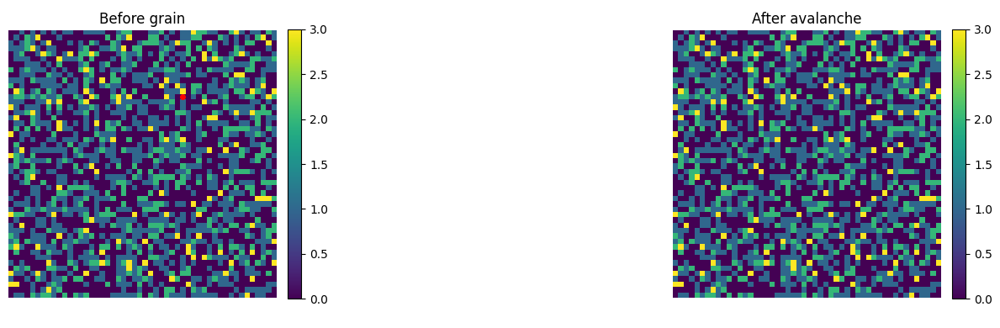

In [1]:
# Sandpile model (Bak–Tang–Wiesenfeld) simulator with visualization
# Paste this into a Jupyter notebook cell and run.

import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# -----------------------------
# Parameters
# -----------------------------
L = 50           # Linear size of grid (L x L)
Zc = 4           # Critical height
N_STEPS = 2000   # Number of random grain additions for long run

# -----------------------------
# Core sandpile functions
# -----------------------------

def init_grid(L):
    """Initialize LxL sandpile grid with zeros."""
    return np.zeros((L, L), dtype=int)

def add_grain(Z):
    """Add one grain at a random site."""
    x = np.random.randint(0, Z.shape[0])
    y = np.random.randint(0, Z.shape[1])
    Z[x, y] += 1
    return (x, y)

def topple(Z, Zc=4, record_states=False, max_topples=None):
    """
    Relax the configuration until all sites are stable:
    - Each site with Z >= Zc topples and sends one grain to each von Neumann neighbor.
    - Grains leaving the boundary are lost.
    
    If record_states=True, return a list of grid snapshots for visualization
    (one snapshot per toppling wave / iteration).
    
    max_topples: optional guard against infinite loops, mostly for debugging.
    """
    Lx, Ly = Z.shape
    snapshots = []
    num_topples = 0
    
    while True:
        unstable = (Z >= Zc)
        if not np.any(unstable):
            break
        
        if record_states:
            snapshots.append(Z.copy())
        
        # Count how many times each site topples in this wave
        T = np.zeros_like(Z, dtype=int)
        T[unstable] = Z[unstable] // Zc  # could be >1 if Z much larger than Zc
        
        num_topples += T.sum()
        if max_topples is not None and num_topples > max_topples:
            print("Warning: max_topples reached, breaking to avoid infinite loop.")
            break
        
        # Remove 4 grains per toppling at each site
        Z[unstable] -= 4 * T[unstable]
        
        # Distribute grains to neighbors
        # Use shifted arrays; boundary grains fall off and are discarded
        # Up
        Z[:-1, :] += T[1:, :]
        # Down
        Z[1:, :] += T[:-1, :]
        # Left
        Z[:, :-1] += T[:, 1:]
        # Right
        Z[:, 1:] += T[:, :-1]
    
    if record_states:
        # final state after relaxation
        snapshots.append(Z.copy())
        return snapshots
    return None

# -----------------------------
# 1) Single avalanche visualization (step-by-step)
# -----------------------------

def run_single_avalanche(L=50, Zc=4):
    """
    Start from a relaxed configuration, add a grain, then visualize
    the avalanche's toppling waves as discrete time steps.
    """
    Z = init_grid(L)
    
    # First, evolve the system a bit so it's not empty (optional)
    for _ in range(2000):
        add_grain(Z)
        topple(Z, Zc=Zc)
    
    # Now take a snapshot, add one grain, and record the avalanche
    Z_before = Z.copy()
    added_site = add_grain(Z)
    snapshots = topple(Z, Zc=Zc, record_states=True)
    
    print(f"Added grain at {added_site}. Avalanche size (waves): {len(snapshots)-1}")
    
    # Plot the evolution
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))
    
    # Initial state before this grain
    im0 = axes[0].imshow(Z_before, vmin=0, vmax=Zc-1, cmap='viridis')
    axes[0].set_title("Before grain")
    axes[0].axis('off')
    fig.colorbar(im0, ax=axes[0], fraction=0.046, pad=0.04)
    
    # Mark the added site on the initial state
    axes[0].plot(added_site[1], added_site[0], 'r.', markersize=8)
    
    # First wave (if exists) and final state
    if len(snapshots) > 1:
        im1 = axes[1].imshow(snapshots[1], vmin=0, vmax=Zc-1, cmap='viridis')
        axes[1].set_title("Early in avalanche")
        axes[1].axis('off')
        fig.colorbar(im1, ax=axes[1], fraction=0.046, pad=0.04)
    else:
        axes[1].axis('off')
    
    im2 = axes[2].imshow(snapshots[-1], vmin=0, vmax=Zc-1, cmap='viridis')
    axes[2].set_title("After avalanche")
    axes[2].axis('off')
    fig.colorbar(im2, ax=axes[2], fraction=0.046, pad=0.04)
    
    plt.tight_layout()
    plt.show()
    
    # Additionally, show each wave as a sequence of frames
    fig2, ax2 = plt.subplots(figsize=(4, 4))
    ax2.set_title("Avalanche evolution (wave by wave)")
    ax2.axis('off')
    im = ax2.imshow(snapshots[0], vmin=0, vmax=Zc-1, cmap='viridis')
    fig2.colorbar(im, ax=ax2, fraction=0.046, pad=0.04)
    
    def update(frame):
        im.set_data(snapshots[frame])
        ax2.set_title(f"Avalanche wave {frame}/{len(snapshots)-1}")
        return [im]
    
    ani = animation.FuncAnimation(fig2, update, frames=len(snapshots), interval=400, blit=True)
    plt.close(fig2)
    
    return HTML(ani.to_jshtml())

# Run and display a single avalanche
html_ani_single = run_single_avalanche(L=L, Zc=Zc)
html_ani_single

In [2]:
# -----------------------------
# 2) Long-run animation over many steps
# -----------------------------
# This shows the sandpile evolving as many random grains are added.

Z = init_grid(L)

# Pre-evolve a bit so we quickly reach a critical state
for _ in range(2000):
    add_grain(Z)
    topple(Z, Zc=Zc)

fig, ax = plt.subplots(figsize=(4, 4))
im = ax.imshow(Z, vmin=0, vmax=Zc-1, cmap='viridis')
ax.set_title("Sandpile evolution")
ax.axis('off')
plt.close(fig)

def step(frame):
    add_grain(Z)
    topple(Z, Zc=Zc)
    im.set_data(Z)
    ax.set_title(f"Step {frame}")
    return [im]

ani_long = animation.FuncAnimation(fig, step, frames=N_STEPS, interval=50, blit=True)

HTML(ani_long.to_jshtml())

Animation size has reached 20973200 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Collected 8655 avalanches.
Estimated τ ≈ 1.05, R² = 0.995


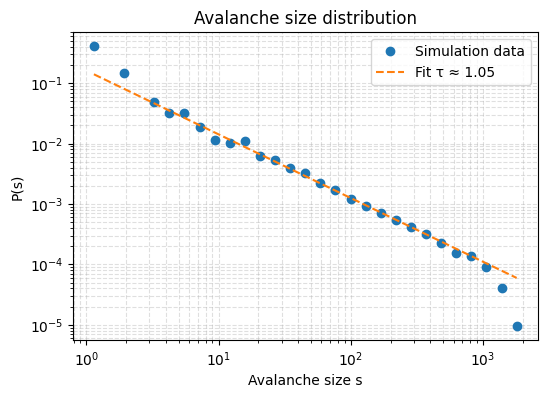

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

# -----------------------------
# Parameters for avalanche statistics
# -----------------------------
L = 50           # grid size
Zc = 4
N_PRE = 5000     # pre-relax steps to reach SOC regime
N_AVAL = 20000   # number of avalanches to record

# -----------------------------
# Core functions (same as before, with avalanche size tracking)
# -----------------------------

def init_grid(L):
    return np.zeros((L, L), dtype=int)

def add_grain(Z):
    x = np.random.randint(0, Z.shape[0])
    y = np.random.randint(0, Z.shape[1])
    Z[x, y] += 1
    return (x, y)

def topple_with_size(Z, Zc=4, max_topples=None):
    """
    Topple until stable and return the avalanche size s:
    s = number of *distinct sites* that topple at least once
    in this relaxation.
    """
    Lx, Ly = Z.shape
    total_toppled_mask = np.zeros_like(Z, dtype=bool)
    
    num_topples_so_far = 0
    while True:
        unstable = (Z >= Zc)
        if not np.any(unstable):
            break
        
        # Sites that topple in this wave
        total_toppled_mask |= unstable
        
        # How many topples per site in this wave
        T = np.zeros_like(Z, dtype=int)
        T[unstable] = Z[unstable] // Zc
        
        num_topples_wave = T.sum()
        num_topples_so_far += num_topples_wave
        if max_topples is not None and num_topples_so_far > max_topples:
            print("Warning: max_topples reached.")
            break
        
        # Remove 4 grains per toppling
        Z[unstable] -= 4 * T[unstable]
        
        # Distribute to neighbors
        Z[:-1, :] += T[1:, :]
        Z[1:, :] += T[:-1, :]
        Z[:, :-1] += T[:, 1:]
        Z[:, 1:] += T[:, :-1]
    
    s = total_toppled_mask.sum()
    return s

# -----------------------------
# 1) Evolve to the critical regime
# -----------------------------
Z = init_grid(L)
for _ in range(N_PRE):
    add_grain(Z)
    topple_with_size(Z, Zc=Zc)

# -----------------------------
# 2) Collect avalanche sizes
# -----------------------------
avalanche_sizes = []

for i in range(N_AVAL):
    add_grain(Z)
    s = topple_with_size(Z, Zc=Zc)
    if s > 0:
        avalanche_sizes.append(s)

avalanche_sizes = np.array(avalanche_sizes)
print(f"Collected {len(avalanche_sizes)} avalanches.")

# -----------------------------
# 3) Histogram and log–log plot
# -----------------------------
# Use logarithmic binning for clearer power-law behavior
s_min = 1
s_max = avalanche_sizes.max()

# Log-spaced bins
num_bins = 30
bins = np.logspace(np.log10(s_min), np.log10(s_max), num_bins)
hist, edges = np.histogram(avalanche_sizes, bins=bins, density=True)
bin_centers = np.sqrt(edges[:-1] * edges[1:])  # geometric mean

# Remove zeros for plotting/fitting
mask = (hist > 0)
bin_centers = bin_centers[mask]
hist = hist[mask]

plt.figure(figsize=(6, 4))
plt.loglog(bin_centers, hist, 'o', label='Simulation data')
plt.xlabel('Avalanche size s')
plt.ylabel('P(s)')
plt.title('Avalanche size distribution')
plt.grid(True, which='both', ls='--', alpha=0.4)

# -----------------------------
# 4) Rough power-law fit P(s) ~ s^{-τ}
# -----------------------------
# Choose fitting range: ignore very small and very large bins
# (strong finite-size/discreteness effects)
fit_mask = (bin_centers >= 2) & (bin_centers <= s_max/5)
x_fit = np.log10(bin_centers[fit_mask])
y_fit = np.log10(hist[fit_mask])

if len(x_fit) > 2:
    slope, intercept, r_value, p_value, std_err = linregress(x_fit, y_fit)
    tau_est = -slope  # because log P ~ -τ log s + const
    print(f"Estimated τ ≈ {tau_est:.2f}, R² = {r_value**2:.3f}")
    
    # Plot fitted line
    x_line = np.log10(bin_centers)
    y_line = slope * x_line + intercept
    plt.loglog(10**x_line, 10**y_line, '--', label=f'Fit τ ≈ {tau_est:.2f}')
else:
    print("Not enough points to fit a power law.")

plt.legend()
plt.show()

Collected 3476 earthquake events.
Estimated b ≈ 1.98, R² = 0.949


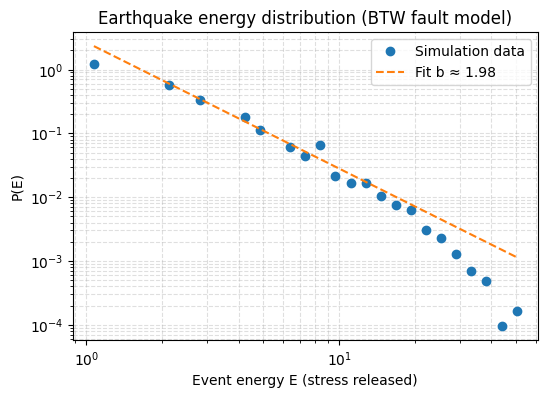

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

# -----------------------------
# Parameters
# -----------------------------
L = 50           # Grid size (L x L)
Zc = 4           # Critical stress threshold
N_PRE = 5000     # Pre-run steps to reach critical state
N_EVENTS = 20000 # Number of "earthquake" events to sample

# -----------------------------
# Earthquake-fault model (BTW sandpile reinterpretation)
# -----------------------------
def init_grid(L):
    """Initialize stress grid."""
    return np.zeros((L, L), dtype=int)

def add_stress(Z):
    """Add 1 unit of stress at a random site."""
    x = np.random.randint(0, Z.shape[0])
    y = np.random.randint(0, Z.shape[1])
    Z[x, y] += 1
    return (x, y)

def relax_and_measure_energy(Z, Zc=4, max_topples=None):
    """
    Relax the grid until all sites are stable (Z < Zc).
    Interpret this as one earthquake event.
    
    Returns:
        E: energy released in the event
           Here we take E = total stress lost from the system,
           i.e. (# topplings) * 4 - stress that falls off boundaries is
           implicitly included because we track total stress before/after.
    """
    initial_total_stress = Z.sum()
    
    Lx, Ly = Z.shape
    num_topples_so_far = 0
    
    while True:
        unstable = (Z >= Zc)
        if not np.any(unstable):
            break
        
        # Number of topples at each site in this wave
        T = np.zeros_like(Z, dtype=int)
        T[unstable] = Z[unstable] // Zc
        
        num_topples_wave = T.sum()
        num_topples_so_far += num_topples_wave
        
        if max_topples is not None and num_topples_so_far > max_topples:
            print("Warning: max_topples reached, breaking.")
            break
        
        # Remove 4 units per toppling from each unstable site
        Z[unstable] -= 4 * T[unstable]
        
        # Distribute 1 unit to each neighbor
        Z[:-1, :] += T[1:, :]   # up
        Z[1:, :] += T[:-1, :]   # down
        Z[:, :-1] += T[:, 1:]   # left
        Z[:, 1:] += T[:, :-1]   # right
    
    final_total_stress = Z.sum()
    # Energy released = stress lost from system
    E = max(initial_total_stress - final_total_stress, 0)
    return E

# -----------------------------
# 1) Pre-run to reach SOC-like regime
# -----------------------------
Z = init_grid(L)

for _ in range(N_PRE):
    add_stress(Z)
    relax_and_measure_energy(Z, Zc=Zc)

# -----------------------------
# 2) Collect "earthquake energies"
# -----------------------------
energies = []

for i in range(N_EVENTS):
    add_stress(Z)
    E = relax_and_measure_energy(Z, Zc=Zc)
    if E > 0:
        energies.append(E)

energies = np.array(energies)
print(f"Collected {len(energies)} earthquake events.")

# -----------------------------
# 3) Histogram and log–log plot for energy distribution
# -----------------------------
E_min = 1
E_max = energies.max()
num_bins = 30
bins = np.logspace(np.log10(E_min), np.log10(E_max), num_bins)
hist, edges = np.histogram(energies, bins=bins, density=True)
E_centers = np.sqrt(edges[:-1] * edges[1:])  # geometric mean of bin edges

mask = (hist > 0)
E_centers = E_centers[mask]
hist = hist[mask]

plt.figure(figsize=(6, 4))
plt.loglog(E_centers, hist, 'o', label="Simulation data")
plt.xlabel("Event energy E (stress released)")
plt.ylabel("P(E)")
plt.title("Earthquake energy distribution (BTW fault model)")
plt.grid(True, which='both', ls='--', alpha=0.4)

# -----------------------------
# 4) Power-law fit P(E) ~ E^{-b}
# -----------------------------
fit_mask = (E_centers >= 2) & (E_centers <= E_max / 5)
x_fit = np.log10(E_centers[fit_mask])
y_fit = np.log10(hist[fit_mask])

if len(x_fit) > 2:
    slope, intercept, r_value, p_value, std_err = linregress(x_fit, y_fit)
    b_est = -slope
    print(f"Estimated b ≈ {b_est:.2f}, R² = {r_value**2:.3f}")
    
    x_line = np.log10(E_centers)
    y_line = slope * x_line + intercept
    plt.loglog(10**x_line, 10**y_line, '--', label=f"Fit b ≈ {b_est:.2f}")
else:
    print("Not enough points to fit a power law.")

plt.legend()
plt.show()

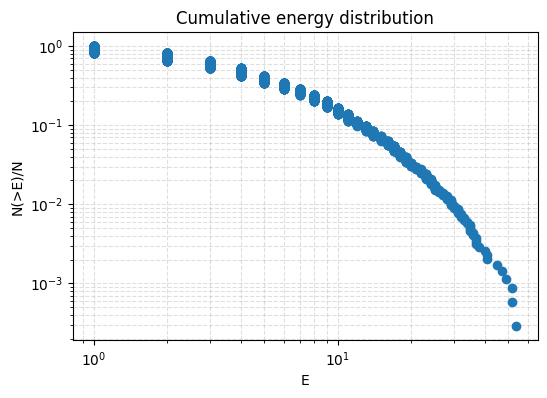

In [5]:
# sort energies
E_sorted = np.sort(energies)
# survival function N(>E)/N_total
N_total = len(E_sorted)
cum_counts = np.arange(N_total, 0, -1)  # N, N-1, ..., 1

plt.figure(figsize=(6,4))
plt.loglog(E_sorted, cum_counts / N_total, 'o')
plt.xlabel('E')
plt.ylabel('N(>E)/N')
plt.title('Cumulative energy distribution')
plt.grid(True, which='both', ls='--', alpha=0.4)
plt.show()

Cumulative N(>E) exponent beta ≈ 0.89, R² = 0.952


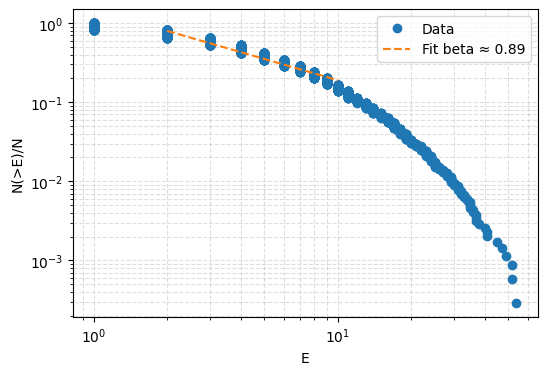

In [6]:
# choose fitting range in energy
E_min_fit = 2
E_max_fit = E_sorted.max() / 5

mask = (E_sorted >= E_min_fit) & (E_sorted <= E_max_fit)
x = np.log10(E_sorted[mask])
y = np.log10(cum_counts[mask] / N_total)

slope, intercept, r_value, p_value, std_err = linregress(x, y)
beta_est = -slope
print(f"Cumulative N(>E) exponent beta ≈ {beta_est:.2f}, R² = {r_value**2:.3f}")

# plot fit
x_line = np.log10(E_sorted[mask])
y_line = slope * x_line + intercept

plt.figure(figsize=(6,4))
plt.loglog(E_sorted, cum_counts / N_total, 'o', label='Data')
plt.loglog(10**x_line, 10**y_line, '--', label=f'Fit beta ≈ {beta_est:.2f}')
plt.xlabel('E')
plt.ylabel('N(>E)/N')
plt.legend()
plt.grid(True, which='both', ls='--', alpha=0.4)
plt.show()

Estimated alpha ≈ 1.50, R² = 1.000


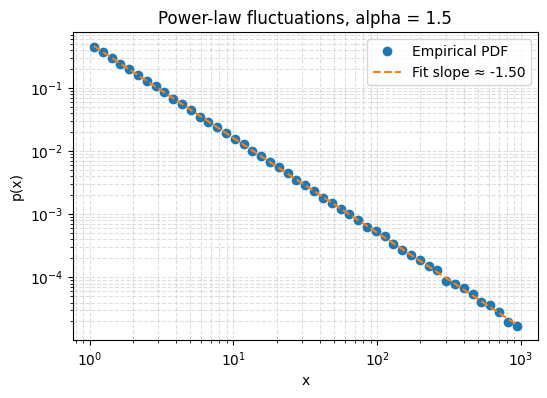

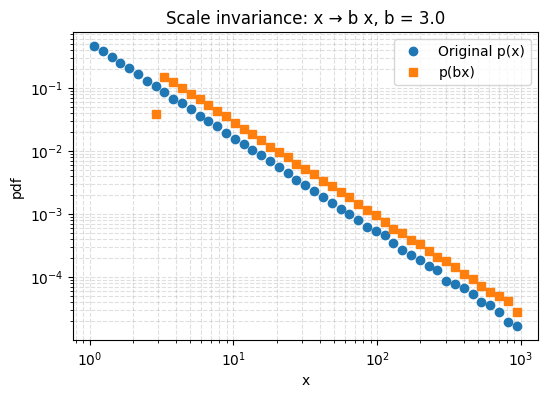

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

# -----------------------------
# 1. Generate power-law fluctuations p(x) ~ x^{-alpha}
# -----------------------------
alpha = 1.5       # exponent
N = 10**5         # number of samples
xmin = 1.0
xmax = 10**3

# Inverse transform sampling for a truncated power law
# CDF for x in [xmin, xmax]: F(x) = (x^{1-alpha} - xmin^{1-alpha}) / (xmax^{1-alpha} - xmin^{1-alpha}), alpha != 1
u = np.random.rand(N)
prefactor = xmax**(1-alpha) - xmin**(1-alpha)
x = (u * prefactor + xmin**(1-alpha))**(1/(1-alpha))

# -----------------------------
# 2. Estimate PDF (histogram) and check power-law behavior
# -----------------------------
num_bins = 50
bins = np.logspace(np.log10(xmin), np.log10(xmax), num_bins)
hist, edges = np.histogram(x, bins=bins, density=True)
centers = np.sqrt(edges[:-1] * edges[1:])  # geometric mean

mask = hist > 0
centers = centers[mask]
hist = hist[mask]

plt.figure(figsize=(6,4))
plt.loglog(centers, hist, 'o', label='Empirical PDF')
plt.xlabel('x')
plt.ylabel('p(x)')
plt.title(f'Power-law fluctuations, alpha = {alpha}')
plt.grid(True, which='both', ls='--', alpha=0.4)

# Fit to confirm slope ~ -alpha
x_fit = np.log10(centers)
y_fit = np.log10(hist)
slope, intercept, r_value, p_value, std_err = linregress(x_fit, y_fit)
alpha_est = -slope
print(f"Estimated alpha ≈ {alpha_est:.2f}, R² = {r_value**2:.3f}")

x_line = np.log10(centers)
y_line = slope * x_line + intercept
plt.loglog(10**x_line, 10**y_line, '--', label=f'Fit slope ≈ {-alpha_est:.2f}')
plt.legend()
plt.show()

# -----------------------------
# 3. Demonstrate scale invariance: p(bx) = b^{-alpha} p(x)
# -----------------------------
b = 3.0  # rescaling factor
x_scaled = b * x  # apply x -> b x

# PDF of scaled variable
hist_scaled, edges_scaled = np.histogram(x_scaled, bins=bins, density=True)
centers_scaled = np.sqrt(edges_scaled[:-1] * edges_scaled[1:])
mask_scaled = hist_scaled > 0
centers_scaled = centers_scaled[mask_scaled]
hist_scaled = hist_scaled[mask_scaled]

plt.figure(figsize=(6,4))
plt.loglog(centers, hist, 'o', label='Original p(x)')
plt.loglog(centers_scaled, hist_scaled, 's', label='p(bx)')
plt.xlabel('x')
plt.ylabel('pdf')
plt.title(f'Scale invariance: x → b x, b = {b}')
plt.grid(True, which='both', ls='--', alpha=0.4)
plt.legend()
plt.show()

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML
from scipy.stats import linregress

# -----------------------------
# Parameters
# -----------------------------
Lx = 80          # horizontal size
Ly = 80          # vertical size (y=0 is top, y=Ly-1 is bottom)
Zc = 2
N_PRE = 5000     # prerun avalanches to approach steady state
N_AVAL = 20000   # number of avalanches for statistics


# -----------------------------
# Directed sandpile model
# -----------------------------
def init_grid(Lx, Ly):
    return np.zeros((Ly, Lx), dtype=int)

def add_grain_top_row(Z):
    """Add a grain at a random site on the top row (y=0)."""
    x = np.random.randint(0, Z.shape[1])
    y = 0
    Z[y, x] += 1
    return (x, y)

def topple_directed(Z, Zc=2, record_states=False):
    """
    Directed toppling: when Z(x, y) >= Zc, remove 2 and send 1 to (x-1, y+1) and (x+1, y+1).
    Grains falling out of the system (left/right or bottom) are lost.

    If record_states=True, return list of snapshots (for animation).
    Also return avalanche size s = number of distinct sites that topple at least once.
    """
    Ly, Lx = Z.shape
    snapshots = []
    toppled_mask = np.zeros_like(Z, dtype=bool)

    while True:
        unstable = (Z >= Zc)
        if not np.any(unstable):
            break

        toppled_mask |= unstable
        if record_states:
            snapshots.append(Z.copy())

        T = np.zeros_like(Z, dtype=int)
        T[unstable] = Z[unstable] // Zc  # how many times each site topples in this wave

        # remove 2 per toppling
        Z[unstable] -= 2 * T[unstable]

        # send 1 to (x-1, y+1) and (x+1, y+1)
        # down-left
        Z[1:, :-1] += T[:-1, 1:]
        # down-right
        Z[1:, 1:] += T[:-1, :-1]

    s = toppled_mask.sum()
    if record_states:
        snapshots.append(Z.copy())
        return snapshots, s
    return None, s


# -----------------------------
# 1) Pre-run to reach steady state
# -----------------------------
Z = init_grid(Lx, Ly)

for _ in range(N_PRE):
    add_grain_top_row(Z)
    _, _ = topple_directed(Z, Zc=Zc, record_states=False)

# -----------------------------
# 2) Visualize a single avalanche (step-by-step)
# -----------------------------
def show_single_avalanche(Z):
    Z_start = Z.copy()
    site = add_grain_top_row(Z)
    snapshots, s = topple_directed(Z, Zc=Zc, record_states=True)
    print(f"Single directed avalanche: size s = {s}, added at {site}")

    fig, ax = plt.subplots(figsize=(4, 6))
    im = ax.imshow(Z_start, vmin=0, vmax=Zc-1, cmap='viridis', origin='upper')
    ax.set_title("Directed avalanche evolution")
    ax.axis('off')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    plt.close(fig)

    def update(frame):
        im.set_data(snapshots[frame])
        ax.set_title(f"Avalanche wave {frame}/{len(snapshots)-1}, size={s}")
        return [im]

    ani = animation.FuncAnimation(fig, update, frames=len(snapshots), interval=300, blit=True)
    return HTML(ani.to_jshtml())

html_ani_directed = show_single_avalanche(Z)
html_ani_directed

Single directed avalanche: size s = 32, added at (17, 0)


Collected 10001 directed avalanches.
Estimated τ ≈ 1.37, R² = 0.983


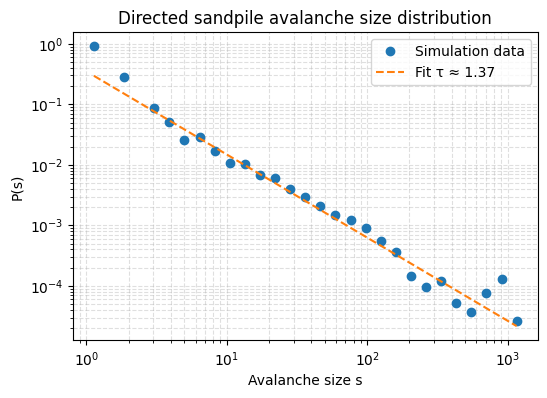

In [9]:
# -----------------------------
# 3) Collect avalanche sizes
# -----------------------------
avalanche_sizes = []

for i in range(N_AVAL):
    add_grain_top_row(Z)
    _, s = topple_directed(Z, Zc=Zc, record_states=False)
    if s > 0:
        avalanche_sizes.append(s)

avalanche_sizes = np.array(avalanche_sizes)
print(f"Collected {len(avalanche_sizes)} directed avalanches.")


# -----------------------------
# 4) Log-binned histogram + power-law fit
# -----------------------------
s_min = 1
s_max = avalanche_sizes.max()

num_bins = 30
bins = np.logspace(np.log10(s_min), np.log10(s_max), num_bins)
hist, edges = np.histogram(avalanche_sizes, bins=bins, density=True)
centers = np.sqrt(edges[:-1] * edges[1:])  # geometric mean

mask = hist > 0
centers = centers[mask]
hist = hist[mask]

plt.figure(figsize=(6,4))
plt.loglog(centers, hist, 'o', label="Simulation data")
plt.xlabel("Avalanche size s")
plt.ylabel("P(s)")
plt.title("Directed sandpile avalanche size distribution")
plt.grid(True, which='both', ls='--', alpha=0.4)

# Fit in scaling range (ignore very small and very large s)
fit_mask = (centers >= 2) & (centers <= s_max / 5)
x_fit = np.log10(centers[fit_mask])
y_fit = np.log10(hist[fit_mask])

if len(x_fit) > 2:
    slope, intercept, r_value, p_value, std_err = linregress(x_fit, y_fit)
    tau_est = -slope
    print(f"Estimated τ ≈ {tau_est:.2f}, R² = {r_value**2:.3f}")
    x_line = np.log10(centers)
    y_line = slope * x_line + intercept
    plt.loglog(10**x_line, 10**y_line, '--', label=f"Fit τ ≈ {tau_est:.2f}")
else:
    print("Not enough points to fit a power law.")

plt.legend()
plt.show()